In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pandas_profiling
import seaborn as sns

In [5]:
teledata=pd.read_csv("C:/Users/gaura/OneDrive/Desktop/Data Science/Python Class/ML Case studies/telco_csv.csv")

In [6]:
teledata.head()

,region,tenure,age,marital,address,income,ed,employ,retire,gender,...,callwait,forward,confer,longmon,tollmon,equipmon,cardmon,wiremon,ebill,custcat
0,2,13,44,1,9,64,4,5,0,0,...,0,1,0,3.70,0.00,0.0,7.50,0.0,0,1
1,3,11,33,1,7,136,5,5,0,0,...,1,1,1,4.40,20.75,0.0,15.25,35.7,0,4
2,3,68,52,1,24,116,1,29,0,1,...,1,0,1,18.15,18.00,0.0,30.25,0.0,0,3
3,2,33,33,0,12,33,2,0,0,1,...,0,0,0,9.45,0.00,0.0,0.00,0.0,0,1
4,2,23,30,1,9,30,1,2,0,0,...,0,1,1,6.30,0.00,0.0,0.00,0.0,0,3


In [7]:
pandas_profiling.ProfileReport(teledata)

In [6]:
teledata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 30 columns):
region      1000 non-null int64
tenure      1000 non-null int64
age         1000 non-null int64
marital     1000 non-null int64
address     1000 non-null int64
income      1000 non-null int64
ed          1000 non-null int64
employ      1000 non-null int64
retire      1000 non-null int64
gender      1000 non-null int64
reside      1000 non-null int64
tollfree    1000 non-null int64
equip       1000 non-null int64
callcard    1000 non-null int64
wireless    1000 non-null int64
multline    1000 non-null int64
voice       1000 non-null int64
pager       1000 non-null int64
internet    1000 non-null int64
callid      1000 non-null int64
callwait    1000 non-null int64
forward     1000 non-null int64
confer      1000 non-null int64
longmon     1000 non-null float64
tollmon     1000 non-null float64
equipmon    1000 non-null float64
cardmon     1000 non-null float64
wiremon     1000 non-n

#### Divinding the Numerical and Categorical Data

In [23]:
teledata_num= [key for key in dict(teledata.dtypes)if dict(teledata.dtypes)[key] in ['int64','float64']]
teledata_cat= [key for key in dict(teledata.dtypes) if dict(teledata.dtypes)[key] in ['object']]

In [24]:
teledata_num=teledata[teledata_num]

In [25]:
teledata_num.head(2)

,region,tenure,age,marital,address,income,ed,employ,retire,gender,...,callwait,forward,confer,longmon,tollmon,equipmon,cardmon,wiremon,ebill,custcat
0,2,13,44,1,9,64,4,5,0,0,...,0,1,0,3.7,0.00,0.0,7.50,0.0,0,1
1,3,11,33,1,7,136,5,5,0,0,...,1,1,1,4.4,20.75,0.0,15.25,35.7,0,4


In [26]:
teledata_cat

[]

#### Handling Outlier 

In [27]:
teledata_num=teledata_num.apply(lambda x : x.clip(lower=x.quantile(0.01),upper=x.quantile(0.99)))

#### Handle Missing Values

In [28]:
def Missing_Imputation (x):
    x=x.fillna(x.mean())
    return x
teledata_num=teledata_num.apply(lambda x:Missing_Imputation (x))

#### Feature Selection

In [29]:
# Aternative to Correlation matrix ( due to Huge no. of variables,its difficult to find correlation))
# So we can use VIF and PCA method for feature selection.
# For PCA we need to standarize the data first.


#### Standardrizing data (To put data on the same scale )

In [30]:
from sklearn.preprocessing import StandardScaler

In [31]:
teledata_num.columns

Index(['region', 'tenure', 'age', 'marital', 'address', 'income', 'ed',
       'employ', 'retire', 'gender', 'reside', 'tollfree', 'equip', 'callcard',
       'wireless', 'multline', 'voice', 'pager', 'internet', 'callid',
       'callwait', 'forward', 'confer', 'longmon', 'tollmon', 'equipmon',
       'cardmon', 'wiremon', 'ebill', 'custcat'],
      dtype='object')

In [32]:
teledata_num.drop(['region','custcat'], axis=1, inplace=True)
# these are categorical variables

In [92]:
sc=StandardScaler()

teledata_scaled=sc.fit_transform(teledata_num)

In [93]:
pd.DataFrame(teledata_scaled).head(10)

,0,1,2,3,4,5,6,7,8,9,...,23,24,25,26,27,28,29,30,31,32
0,-1.055125,0.189446,1.010051,-0.252674,-0.126231,1.087753,-0.597197,-0.222076,-1.034598,-0.229045,...,-0.824695,-0.749071,-0.457615,-0.598794,-0.768001,-0.045301,-0.140350,-1.356323,1.511617,0.988322
1,-1.148806,-0.695476,1.010051,-0.453208,0.802534,1.906227,-0.597197,-0.222076,-1.034598,2.607427,...,0.484856,-0.749071,0.121006,1.275872,-0.768001,-1.460965,-1.382389,0.292702,-1.520106,-1.392030
2,1.521092,0.833025,1.010051,1.251336,0.544543,-1.367671,1.811218,-0.222076,0.966559,-0.229045,...,0.311301,-0.749071,1.240918,-0.598794,-0.768001,1.370363,1.101688,-0.531811,-0.307417,-0.915960
3,-0.118319,-0.695476,-0.990050,0.048128,-0.526115,-0.549196,-1.098950,-0.222076,0.966559,-0.938163,...,-0.824695,-0.749071,-1.017571,-0.598794,-0.768001,-0.045301,-0.140350,1.117215,-0.913761,1.464393
4,-0.586722,-0.936819,1.010051,-0.252674,-0.564814,-1.367671,-0.898249,-0.222076,-1.034598,1.189191,...,-0.824695,-0.749071,-1.017571,-0.598794,-0.768001,-0.045301,-0.140350,-1.356323,1.511617,0.988322
5,0.256404,-0.212792,-0.990050,0.549465,0.054362,-0.549196,0.506660,-0.222076,0.966559,-0.938163,...,0.390189,-0.749071,-0.009650,-0.598794,-0.768001,1.370363,1.101688,-0.531811,-0.307417,-0.915960
6,0.443765,-1.580398,1.010051,-0.954544,-0.706708,-0.549196,-0.697547,-0.222076,0.966559,1.898309,...,-0.824695,-0.749071,-0.364289,-0.598794,1.302082,-0.045301,-0.140350,1.117215,-0.913761,-0.439889
7,0.115883,-0.534581,-0.990050,-0.653743,0.028563,-0.549196,-0.095443,-0.222076,-1.034598,0.480073,...,2.015295,1.899915,0.718293,2.809212,1.302082,-1.460965,-1.382389,0.292702,0.298928,0.036181
8,0.443765,1.396158,1.010051,-0.453208,1.189519,1.087753,2.011920,-0.222076,-1.034598,1.898309,...,0.973965,-0.749071,-0.121641,-0.598794,-0.768001,1.370363,1.101688,-0.531811,-0.307417,-0.915960
9,1.521092,-0.051897,1.010051,0.950534,-0.023035,-1.367671,1.108764,-0.222076,-1.034598,0.480073,...,-0.824695,-0.749071,0.214332,-0.598794,-0.768001,-0.045301,-0.140350,-1.356323,1.511617,0.988322


In [94]:
# Standarize the data - mean should be '0'and standard Deviation should be '1'.
pd.DataFrame(teledata_scaled).describe()

,0,1,2,3,4,5,6,7,8,9,...,23,24,25,26,27,28,29,30,31,32
count,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03,...,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03,1.000000e+03
mean,-1.512124e-16,3.602674e-17,3.996803e-17,4.796163e-17,4.113376e-17,1.661449e-16,1.335598e-16,3.025358e-16,-2.111644e-16,-1.275091e-16,...,7.649437e-17,-2.380318e-16,-9.711676e-17,-2.975398e-17,2.264855e-17,8.222589e-17,4.493628e-17,5.639933e-17,2.772227e-16,-3.955725e-16
std,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00,...,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00,1.000500e+00
min,-1.617209e+00,-1.741293e+00,-9.900495e-01,-1.155079e+00,-8.100333e-01,-1.367671e+00,-1.098950e+00,-2.220764e-01,-1.034598e+00,-9.381632e-01,...,-8.246952e-01,-7.490708e-01,-1.017571e+00,-5.987943e-01,-7.680007e-01,-1.460965e+00,-1.382389e+00,-1.356323e+00,-1.520106e+00,-1.392030e+00
25%,-8.677637e-01,-7.759238e-01,-9.900495e-01,-8.542771e-01,-5.777133e-01,-5.491964e-01,-7.978979e-01,-2.220764e-01,-1.034598e+00,-9.381632e-01,...,-8.246952e-01,-7.490708e-01,-1.017571e+00,-5.987943e-01,-7.680007e-01,-4.530125e-02,-1.403504e-01,-5.318107e-01,-9.137612e-01,-9.159595e-01
50%,-7.147832e-02,-1.323441e-01,-9.900495e-01,-2.526735e-01,-3.455222e-01,2.692781e-01,-2.961447e-01,-2.220764e-01,9.665588e-01,-2.290451e-01,...,-8.246952e-01,-7.490708e-01,-1.216411e-01,-5.987943e-01,-7.680007e-01,-4.530125e-02,-1.403504e-01,2.927020e-01,-3.074167e-01,3.618135e-02
75%,8.653280e-01,7.525780e-01,1.010051e+00,6.497319e-01,1.188599e-01,1.087753e+00,6.070109e-01,-2.220764e-01,9.665588e-01,4.800729e-01,...,7.057438e-01,9.151374e-01,5.129756e-01,6.988998e-01,1.302082e+00,1.370363e+00,1.101688e+00,1.117215e+00,9.052724e-01,9.883223e-01
max,1.708454e+00,2.281884e+00,1.010051e+00,3.156414e+00,4.988164e+00,1.906227e+00,2.916079e+00,4.502954e+00,9.665588e-01,2.607427e+00,...,3.183793e+00,2.500299e+00,3.611398e+00,2.988408e+00,1.302082e+00,1.370363e+00,2.343727e+00,1.941727e+00,1.511617e+00,1.464393e+00


#### Applying PCA

###### we dont know , how much components we take, so on starting we have to take no. of components as no of variable.
pc = PCA(n_components=28)

In [95]:
from sklearn.decomposition import PCA
from sklearn.decomposition import FactorAnalysis
pc = PCA(n_components=28)
pc.fit(teledata_scaled)

PCA(copy=True, iterated_power='auto', n_components=28, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [37]:
# Eigen Values
pc.explained_variance_ 

array([6.66244068, 4.91326268, 2.87933837, 1.80304708, 1.2109082 ,
       1.08062741, 0.99708147, 0.86501531, 0.79050289, 0.68337533,
       0.6109398 , 0.58922782, 0.54240372, 0.48141267, 0.45938891,
       0.43754823, 0.42668323, 0.38936756, 0.36180249, 0.35410928,
       0.33468637, 0.30274398, 0.24838842, 0.20014787, 0.19315674,
       0.11451467, 0.0687937 , 0.02711315])

In [38]:
sum(pc.explained_variance_)

28.028028028028054

In [39]:
#The amount of variance that each PC explains
var= pc.explained_variance_ratio_
var

array([0.23770637, 0.17529819, 0.10273068, 0.06433014, 0.04320347,
       0.03855524, 0.03557444, 0.03086251, 0.02820401, 0.02438186,
       0.02179746, 0.02102281, 0.01935219, 0.01717612, 0.01639034,
       0.0156111 , 0.01522345, 0.01389208, 0.0129086 , 0.01263411,
       0.01194113, 0.01080147, 0.00886214, 0.00714099, 0.00689156,
       0.00408572, 0.00245446, 0.00096736])

In [40]:
#Cumulative Variance explains
var1=np.cumsum(np.round(pc.explained_variance_ratio_, decimals=4)*100)
var1

array([ 23.77,  41.3 ,  51.57,  58.  ,  62.32,  66.18,  69.74,  72.83,
        75.65,  78.09,  80.27,  82.37,  84.31,  86.03,  87.67,  89.23,
        90.75,  92.14,  93.43,  94.69,  95.88,  96.96,  97.85,  98.56,
        99.25,  99.66,  99.91, 100.01])


#### number of components have choosen as 9 based on cumulative variacne is explaining >75 % and individual component explaining >0.8 variance


In [96]:
# Now Analyzing PCA with components = 9
pc_final = PCA(n_components=9)
pc_final.fit(teledata_scaled)

PCA(copy=True, iterated_power='auto', n_components=9, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [42]:
pc_final.explained_variance_ 

array([6.66244068, 4.91326268, 2.87933837, 1.80304697, 1.21090266,
       1.08054726, 0.99707405, 0.86476541, 0.79042774])

In [97]:
reduced_cr=pc_final.fit_transform(teledata_scaled)

In [44]:
dimensions = pd.DataFrame(reduced_cr)
dimensions.columns = ["C1", "C2", "C3", "C4", "C5", "C6", "C7","C8","C9"]

In [45]:
dimensions.head()

,C1,C2,C3,C4,C5,C6,C7,C8,C9
0,-2.304555,0.054443,-0.795981,0.374346,0.187016,-0.705249,0.900209,0.879626,0.170582
1,2.878860,-0.970364,-2.911936,1.740324,1.370854,-0.033378,1.049289,1.092439,-1.353825
2,0.627668,3.970786,-0.274089,0.554804,0.663844,0.186120,-0.732716,0.466427,1.107063
3,-3.614707,-0.087756,-0.486562,-1.037447,-0.151092,0.128825,-1.051243,-0.239895,-1.107644
4,-2.120426,0.041323,-2.498479,1.167484,0.244385,0.493693,1.328601,0.073118,-0.195963


#### Factor Loading Matrix

Loadings=Eigenvectors * sqrt(Eigenvalues)

loadings are the covariances/correlations between the original variables and the unit-scaled components.


In [46]:
Loadings =  pd.DataFrame((pc_final.components_.T * np.sqrt(pc_final.explained_variance_)).T,columns=teledata_num.columns).T

In [47]:
Loadings.to_csv("Loadings.csv")

#### Clustering

In [48]:
#selected the list variables from PCA based on factor loading matrics
list_var = ['wiremon','tollmon','tenure','retire','gender','voice','tollfree','reside','pager']

In [98]:
# Previous Data
teledata_scaled1=pd.DataFrame(teledata_scaled, columns=teledata_num.columns)
teledata_scaled1.head(5)


,tenure,age,marital,address,income,ed,employ,retire,gender,reside,...,tollmon,equipmon,cardmon,wiremon,ebill,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7
0,-1.055125,0.189446,1.010051,-0.252674,-0.126231,1.087753,-0.597197,-0.222076,-1.034598,-0.229045,...,-0.824695,-0.749071,-0.457615,-0.598794,-0.768001,-0.045301,-0.140350,-1.356323,1.511617,0.988322
1,-1.148806,-0.695476,1.010051,-0.453208,0.802534,1.906227,-0.597197,-0.222076,-1.034598,2.607427,...,0.484856,-0.749071,0.121006,1.275872,-0.768001,-1.460965,-1.382389,0.292702,-1.520106,-1.392030
2,1.521092,0.833025,1.010051,1.251336,0.544543,-1.367671,1.811218,-0.222076,0.966559,-0.229045,...,0.311301,-0.749071,1.240918,-0.598794,-0.768001,1.370363,1.101688,-0.531811,-0.307417,-0.915960
3,-0.118319,-0.695476,-0.990050,0.048128,-0.526115,-0.549196,-1.098950,-0.222076,0.966559,-0.938163,...,-0.824695,-0.749071,-1.017571,-0.598794,-0.768001,-0.045301,-0.140350,1.117215,-0.913761,1.464393
4,-0.586722,-0.936819,1.010051,-0.252674,-0.564814,-1.367671,-0.898249,-0.222076,-1.034598,1.189191,...,-0.824695,-0.749071,-1.017571,-0.598794,-0.768001,-0.045301,-0.140350,-1.356323,1.511617,0.988322


In [99]:
# Data After Clustring
teledata_scaled2=teledata_scaled1[list_var]
teledata_scaled2.head(5)


,wiremon,tollmon,tenure,retire,gender,voice,tollfree,reside,pager
0,-0.598794,-0.824695,-1.055125,-0.222076,-1.034598,-0.660895,-0.949284,-0.229045,-0.594289
1,1.275872,0.484856,-1.148806,-0.222076,-1.034598,1.513101,1.053425,2.607427,1.682682
2,-0.598794,0.311301,1.521092,-0.222076,0.966559,-0.660895,1.053425,-0.229045,-0.594289
3,-0.598794,-0.824695,-0.118319,-0.222076,0.966559,-0.660895,-0.949284,-0.938163,-0.594289
4,-0.598794,-0.824695,-0.586722,-0.222076,-1.034598,-0.660895,-0.949284,1.189191,-0.594289


#### Segmentation (Kmeans)

In [51]:
from sklearn.cluster import KMeans

In [100]:
# Dividing the data into 3 groups
km_3=KMeans(n_clusters=3,random_state=123)
km_3.fit(teledata_scaled2)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=3, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=123, tol=0.0001, verbose=0)

In [101]:
km_3.labels_

array([1, 0, 2, 1, 1, 2, 1, 0, 2, 1, 1, 2, 1, 0, 1, 1, 2, 2, 1, 1, 1, 1,
       1, 1, 2, 2, 0, 1, 1, 1, 1, 0, 2, 1, 0, 1, 0, 0, 2, 2, 2, 2, 1, 0,
       2, 1, 2, 1, 1, 2, 1, 1, 0, 2, 2, 2, 1, 1, 2, 1, 2, 0, 1, 1, 0, 1,
       2, 2, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 0, 0, 1, 0, 2, 1, 1, 1, 0,
       0, 2, 1, 2, 1, 0, 1, 1, 1, 2, 2, 1, 1, 1, 2, 1, 1, 2, 1, 0, 1, 1,
       1, 2, 1, 1, 2, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 0, 2, 1,
       0, 1, 0, 1, 1, 1, 2, 0, 0, 2, 0, 1, 0, 2, 0, 1, 1, 1, 1, 2, 0, 0,
       0, 2, 1, 1, 1, 1, 2, 2, 1, 1, 1, 1, 0, 1, 1, 1, 0, 2, 0, 1, 1, 2,
       1, 0, 0, 1, 0, 2, 1, 1, 1, 1, 1, 0, 0, 2, 1, 0, 1, 2, 0, 1, 1, 2,
       1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 2, 1, 1, 1, 1, 1, 1, 1, 2, 0, 1,
       1, 0, 1, 2, 1, 0, 0, 2, 2, 2, 2, 2, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0,
       2, 1, 1, 2, 2, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 2, 1,
       1, 1, 2, 2, 1, 1, 1, 1, 0, 1, 2, 2, 1, 2, 1, 1, 0, 0, 2, 1, 1, 2,
       0, 2, 2, 2, 2, 1, 1, 2, 0, 0, 2, 1, 0, 1, 2,

In [102]:
# Centroids... here we have 3 centoids with dimension of 9 (no. of variables)
# centroids == no.of segmentation
km_3.cluster_centers_

array([[ 1.49056903,  0.85485135,  0.01159318, -0.10092181, -0.00836381,
         1.22509277,  0.83946051,  0.18915269,  1.50753005],
       [-0.48244945, -0.82469519, -0.06567013, -0.03307521,  0.01801041,
        -0.4087111 , -0.9492843 , -0.03474678, -0.48499485],
       [-0.40439259,  0.79816684,  0.11324157,  0.15095229, -0.02649652,
        -0.30945923,  1.04589621, -0.10108398, -0.41452859]])

In [179]:
km_4=KMeans(n_clusters=4,random_state=123).fit(teledata_scaled2)
km_5=KMeans(n_clusters=5,random_state=123).fit(teledata_scaled2)
km_6=KMeans(n_clusters=6,random_state=123).fit(teledata_scaled2)
km_7=KMeans(n_clusters=7,random_state=123).fit(teledata_scaled2)
km_8=KMeans(n_clusters=8,random_state=123).fit(teledata_scaled2)

In [181]:
# Conactenating labels found through Kmeans with data 
#cluster_df_4=pd.concat([teledata_num,pd.Series(km_4.labels_,name='Cluster_4')],axis=1)

# save the cluster labels and sort by cluster
teledata_num['cluster_3'] = km_3.labels_
teledata_num['cluster_4'] = km_4.labels_
teledata_num['cluster_5'] = km_5.labels_
teledata_num['cluster_6'] = km_6.labels_
teledata_num['cluster_7'] = km_7.labels_
teledata_num['cluster_8'] = km_8.labels_

In [182]:
teledata_num.head()

,tenure,age,marital,address,income,ed,employ,retire,gender,reside,...,equipmon,cardmon,wiremon,ebill,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,cluster_8
0,13,44.0,1,9,64.0,4,5.0,0,0,2,...,0.0,7.50,0.0,0,1,1,0,5,5,6
1,11,33.0,1,7,136.0,5,5.0,0,0,6,...,0.0,15.25,35.7,0,0,0,2,0,0,3
2,68,52.0,1,24,116.0,1,29.0,0,1,2,...,0.0,30.25,0.0,0,2,2,1,2,1,7
3,33,33.0,0,12,33.0,2,0.0,0,1,1,...,0.0,0.00,0.0,0,1,1,3,1,6,2
4,23,30.0,1,9,30.0,1,2.0,0,0,4,...,0.0,0.00,0.0,0,1,1,0,5,5,0


In [191]:
pd.Series(km_3.labels_).value_counts()

1    500
2    266
0    234
dtype: int64

In [192]:
pd.Series(km_3.labels_).value_counts()/sum(pd.Series(km_3.labels_).value_counts())

1    0.500
2    0.266
0    0.234
dtype: float64

In [193]:
pd.Series(km_5.labels_).value_counts()/sum(pd.Series(km_5.labels_).value_counts())

3    0.252
1    0.245
2    0.228
0    0.228
4    0.047
dtype: float64

### Choosing number clusters using Silhouette Coefficient

In [194]:
# calculate SC for K=3
from sklearn import metrics
metrics.silhouette_score(teledata_scaled2, km_3.labels_)

0.2599861777391157

In [195]:
# calculate SC for K=3 through K=12
k_range = range(3, 9)
scores = []
for k in k_range:
    km = KMeans(n_clusters=k, random_state=123)
    km.fit(teledata_scaled2)
    scores.append(metrics.silhouette_score(teledata_scaled2, km.labels_))

In [196]:
scores
# K=4 have max. Sillhoutte Coefficient Score 

[0.2599861777391157,
 0.2769578754297612,
 0.2515099466761122,
 0.24058052262096483,
 0.224119252317925,
 0.2471179489335068]

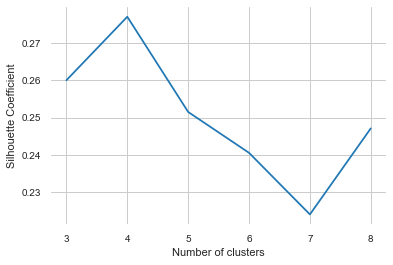

In [197]:
# plot the results
plt.plot(k_range, scores)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette Coefficient')
plt.grid(True)

#### The solution can be 4, If we take highest SC score, 4 segment solution is best

#### Segment Distribution

In [198]:
teledata_num.cluster_4.value_counts()/sum(teledata_num.cluster_4.value_counts())

1    0.480
2    0.246
0    0.227
3    0.047
Name: cluster_4, dtype: float64

### Profiling

In [199]:
teledata_num.head()

,tenure,age,marital,address,income,ed,employ,retire,gender,reside,...,equipmon,cardmon,wiremon,ebill,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,cluster_8
0,13,44.0,1,9,64.0,4,5.0,0,0,2,...,0.0,7.50,0.0,0,1,1,0,5,5,6
1,11,33.0,1,7,136.0,5,5.0,0,0,6,...,0.0,15.25,35.7,0,0,0,2,0,0,3
2,68,52.0,1,24,116.0,1,29.0,0,1,2,...,0.0,30.25,0.0,0,2,2,1,2,1,7
3,33,33.0,0,12,33.0,2,0.0,0,1,1,...,0.0,0.00,0.0,0,1,1,3,1,6,2
4,23,30.0,1,9,30.0,1,2.0,0,0,4,...,0.0,0.00,0.0,0,1,1,0,5,5,0


###### Distribution

In [200]:
teledata_num.cluster_3.value_counts()/1000

1    0.500
2    0.266
0    0.234
Name: cluster_3, dtype: float64

###### Percentage Distribution 

In [201]:
teledata_num.cluster_3.value_counts()*100/sum(teledata_num.cluster_3.value_counts())

1    50.0
2    26.6
0    23.4
Name: cluster_3, dtype: float64

##### Distribution in sorting order

In [202]:
pd.Series.sort_index(teledata_num.cluster_3.value_counts())

0    234
1    500
2    266
Name: cluster_3, dtype: int64

In [222]:
size=pd.concat([pd.Series(teledata_num.cluster_3.size), pd.Series.sort_index(teledata_num.cluster_3.value_counts()), pd.Series.sort_index(teledata_num.cluster_4.value_counts()),
           pd.Series.sort_index(teledata_num.cluster_5.value_counts()), pd.Series.sort_index(teledata_num.cluster_6.value_counts()),
           pd.Series.sort_index(teledata_num.cluster_7.value_counts()),pd.Series.sort_index(teledata_num.cluster_8.value_counts())])

In [223]:
size

0    1000
0     234
1     500
2     266
0     227
1     480
2     246
3      47
0     228
1     245
2     228
3     252
4      47
0      84
1     252
2     240
3     149
4      47
5     228
0     136
1     228
2     117
3     110
4      47
5     228
6     134
0     108
1     130
2     197
3     127
4      47
5      94
6     174
7     123
dtype: int64

In [224]:
Seg_size=pd.DataFrame(size, columns=['Seg_size']) # Segment Size
Seg_Pct = pd.DataFrame(size/teledata_num.cluster_3.size, columns=['Seg_Pct']) # Segment Percentage
Seg_size.T

,0,0,1,2,0,1,2,3,0,1,...,5,6,0,1,2,3,4,5,6,7
Seg_size,1000,234,500,266,227,480,246,47,228,245,...,228,134,108,130,197,127,47,94,174,123


In [225]:
Seg_Pct.T

,0,0,1,2,0,1,2,3,0,1,...,5,6,0,1,2,3,4,5,6,7
Seg_Pct,1.0,0.234,0.5,0.266,0.227,0.48,0.246,0.047,0.228,0.245,...,0.228,0.134,0.108,0.13,0.197,0.127,0.047,0.094,0.174,0.123


In [226]:
pd.concat([Seg_size.T, Seg_Pct.T], axis=0)

,0,0,1,2,0,1,2,3,0,1,...,5,6,0,1,2,3,4,5,6,7
Seg_size,1000.0,234.000,500.0,266.000,227.000,480.00,246.000,47.000,228.000,245.000,...,228.000,134.000,108.000,130.00,197.000,127.000,47.000,94.000,174.000,123.000
Seg_Pct,1.0,0.234,0.5,0.266,0.227,0.48,0.246,0.047,0.228,0.245,...,0.228,0.134,0.108,0.13,0.197,0.127,0.047,0.094,0.174,0.123


In [227]:
teledata_num.head(4)

,tenure,age,marital,address,income,ed,employ,retire,gender,reside,...,equipmon,cardmon,wiremon,ebill,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,cluster_8
0,13,44.0,1,9,64.0,4,5.0,0,0,2,...,0.0,7.50,0.0,0,1,1,0,5,5,6
1,11,33.0,1,7,136.0,5,5.0,0,0,6,...,0.0,15.25,35.7,0,0,0,2,0,0,3
2,68,52.0,1,24,116.0,1,29.0,0,1,2,...,0.0,30.25,0.0,0,2,2,1,2,1,7
3,33,33.0,0,12,33.0,2,0.0,0,1,1,...,0.0,0.00,0.0,0,1,1,3,1,6,2


In [228]:
teledata_num.groupby('cluster_3').apply(lambda x :x.mean()).T

cluster_3,0,1,2
tenure,35.773504,34.12400,37.943609
age,40.991453,40.69814,44.000113
marital,0.576923,0.48600,0.439850
address,11.106838,11.01600,12.830827
income,91.790085,62.76980,78.653835
ed,3.324786,2.58200,2.263158
employ,10.555598,9.79408,13.473872
retire,0.025641,0.04000,0.078947
gender,0.512821,0.52600,0.503759
reside,2.589744,2.27400,2.180451


In [238]:
###Mean value gives a good indication of the distribution of data. So we are finding mean value for each variable for each cluster
Profling_output = pd.concat([teledata_num.apply(lambda x: x.mean()).T, teledata_num.groupby('cluster_3').apply(lambda x: x.mean()).T, teledata_num.groupby('cluster_4').apply(lambda x: x.mean()).T,
          teledata_num.groupby('cluster_5').apply(lambda x: x.mean()).T, teledata_num.groupby('cluster_6').apply(lambda x: x.mean()).T,
          teledata_num.groupby('cluster_7').apply(lambda x: x.mean()).T,teledata_num.groupby('cluster_8').apply(lambda x: x.mean()).T], axis=1)



In [239]:
Profling_output.head()

,0,0,1,2,0,1,2,3,0,1,...,5,6,0,1,2,3,4,5,6,7
tenure,35.5260,35.773504,34.12400,37.943609,35.281938,33.435417,36.686992,51.978723,33.947368,36.763265,...,33.947368,15.813433,34.212963,36.215385,33.598985,20.590551,51.978723,54.446809,32.954023,37.349593
age,41.6451,40.991453,40.69814,44.000113,40.431718,39.645854,42.178862,65.129574,40.109649,42.195918,...,40.109649,34.514925,35.444444,42.800000,40.182792,36.141732,65.129574,46.042553,41.758621,41.398374
marital,0.4950,0.576923,0.48600,0.439850,0.581498,0.497917,0.443089,0.319149,0.495614,0.444898,...,0.495614,0.455224,0.953704,0.461538,0.380711,0.566929,0.319149,0.595745,0.350575,0.430894
address,11.5200,11.106838,11.01600,12.830827,10.744493,10.491667,11.821138,24.191489,10.447368,11.836735,...,10.447368,6.716418,8.509259,12.715385,11.213198,7.354331,24.191489,15.042553,10.959770,10.951220
income,73.7857,91.790085,62.76980,78.653835,93.400352,64.416583,80.881951,37.593617,61.309123,81.028408,...,61.309123,50.388060,49.092593,74.211385,70.662335,72.141732,37.593617,124.105106,67.106207,86.540488


In [240]:
Profling_output_final=pd.concat([Seg_size.T, Seg_Pct.T, Profling_output], axis=0)

In [241]:
Profling_output_final.head()

,0,0,1,2,0,1,2,3,0,1,...,5,6,0,1,2,3,4,5,6,7
Seg_size,1000.0000,234.000000,500.00000,266.000000,227.000000,480.000000,246.000000,47.000000,228.000000,245.000000,...,228.000000,134.000000,108.000000,130.000000,197.000000,127.000000,47.000000,94.000000,174.000000,123.000000
Seg_Pct,1.0000,0.234000,0.50000,0.266000,0.227000,0.480000,0.246000,0.047000,0.228000,0.245000,...,0.228000,0.134000,0.108000,0.130000,0.197000,0.127000,0.047000,0.094000,0.174000,0.123000
tenure,35.5260,35.773504,34.12400,37.943609,35.281938,33.435417,36.686992,51.978723,33.947368,36.763265,...,33.947368,15.813433,34.212963,36.215385,33.598985,20.590551,51.978723,54.446809,32.954023,37.349593
age,41.6451,40.991453,40.69814,44.000113,40.431718,39.645854,42.178862,65.129574,40.109649,42.195918,...,40.109649,34.514925,35.444444,42.800000,40.182792,36.141732,65.129574,46.042553,41.758621,41.398374
marital,0.4950,0.576923,0.48600,0.439850,0.581498,0.497917,0.443089,0.319149,0.495614,0.444898,...,0.495614,0.455224,0.953704,0.461538,0.380711,0.566929,0.319149,0.595745,0.350575,0.430894


##### Giving the name of Variables

In [242]:
#Profling_output_final.columns = ['Seg_' + str(i) for i in Profling_output_final.columns]
Profling_output_final.columns = ['Overall', 'KM3_1', 'KM3_2', 'KM3_3',
                                'KM4_1', 'KM4_2', 'KM4_3', 'KM4_4',
                                'KM5_1', 'KM5_2', 'KM5_3', 'KM5_4', 'KM5_5',
                                'KM6_1', 'KM6_2', 'KM6_3', 'KM6_4', 'KM6_5','KM6_6',
                                'KM7_1', 'KM7_2', 'KM7_3', 'KM7_4', 'KM7_5','KM7_6','KM7_7',
                                'KM8_1', 'KM8_2', 'KM8_3', 'KM8_4', 'KM8_5','KM8_6','KM8_7','KM8_8']
                                
                        

In [243]:
Profling_output_final.head(2)

,Overall,KM3_1,KM3_2,KM3_3,KM4_1,KM4_2,KM4_3,KM4_4,KM5_1,KM5_2,...,KM7_6,KM7_7,KM8_1,KM8_2,KM8_3,KM8_4,KM8_5,KM8_6,KM8_7,KM8_8
Seg_size,1000.0,234.000,500.0,266.000,227.000,480.00,246.000,47.000,228.000,245.000,...,228.000,134.000,108.000,130.00,197.000,127.000,47.000,94.000,174.000,123.000
Seg_Pct,1.0,0.234,0.5,0.266,0.227,0.48,0.246,0.047,0.228,0.245,...,0.228,0.134,0.108,0.13,0.197,0.127,0.047,0.094,0.174,0.123


In [247]:
Profling_output_final.to_csv('TeleProfiling_output.csv')